In [54]:
import sys
sys.path.append('../src/denoiser/')
import gc
import h5py
import torch
import numpy as np
import torch.nn as nn
from das_util import try_gpu
from matplotlib import pyplot as plt
from numpy.random import default_rng
from scipy.signal import filtfilt, butter
from torch.utils.data import DataLoader
from denodas_model import unet, dataflow, datalabel
from sklearn.model_selection import train_test_split

import matplotlib


In [7]:
data_terra = '/fd1/QibinShi_data/akdas/qibin_data/TERRAtill2023_11_11.hdf5'
data_kkfls = '/fd1/QibinShi_data/akdas/qibin_data/KKFLStill2023_11_11.hdf5'
with h5py.File(data_terra, 'r') as f:
    quake1 = f['raw_quake'][:]
with h5py.File(data_kkfls, 'r') as f:
    quake2 = f['raw_quake'][:]
    
sample_rate = 25
delta_space = 10
    
tmp = np.append(quake2[:,:4500,:], quake1[:,:4500,:], axis=0)

b, a = butter(4, (0.5, 12), fs=sample_rate, btype='bandpass')
filt = filtfilt(b, a, tmp, axis=2)
rawdata = filt / np.std(filt, axis=(1,2), keepdims=True)

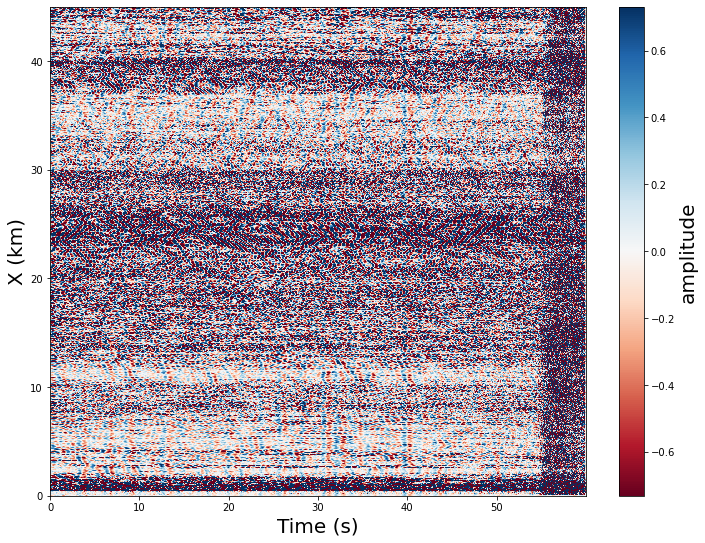

In [8]:
# %% visualize data
time_data = rawdata[5]
plt.figure(figsize=(12, 9)); cmap=plt.cm.get_cmap('RdBu'); max_amp = np.median(np.fabs(time_data))*2
x, y=np.arange(time_data.shape[1]), np.arange(time_data.shape[0])
plt.pcolormesh(x, y, time_data, shading='auto', vmin=-max_amp, vmax=max_amp, cmap=cmap)
plt.xticks(np.arange(0, 1500, 250), np.arange(0, 1500/sample_rate, 250/sample_rate).astype(int))
plt.yticks(np.arange(0, 4500, 1000), (np.arange(0, delta_space*4500, 1000*delta_space)/1000).astype(int))
plt.xlabel("Time (s)", fontsize=20); plt.ylabel("X (km)", fontsize=20)
cbr=plt.colorbar(); cbr.set_label('amplitude', fontsize = 20)

In [9]:
# %% Shuffle and split dataset
X_tr, X, Y_tr, Y = train_test_split(rawdata, rawdata,
                                        train_size=0.7,
                                        random_state=111)
X_va, X_te, Y_va, Y_te = train_test_split(X, Y,
                                        train_size=0.5,
                                        random_state=121)

In [25]:
subtest= X_te[:,500:2000,:]
subtest= subtest/ np.std(subtest, axis=(1,2), keepdims=True)
test_data = dataflow(subtest, stride=1500, mask_ratio=0.2, n_masks=1)
print(len(test_data))


86


In [12]:
""" Initialize the U-net model """
model = unet(1, 16, 1024, factors=(5, 3, 2, 2), use_att=False)
devc = try_gpu(i=0)
model = nn.DataParallel(model, device_ids=[0,1,2,3])  # comment if gpus<4 
model.to(devc)

model.load_state_dict(torch.load('/home/qibins/DenoDAS/models/checkpoint_noatt_LRdecays0.8_mask0.5_raw2raw_chmax4500.pt')) 
model.eval()

DataParallel(
  (module): unet(
    (relu): ReLU()
    (layer): ModuleList(
      (0): Conv2d(1, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (1): Conv2d(16, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (2): MaxBlurPool2d()
      (3): Conv2d(16, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (4): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (5): MaxBlurPool2d()
      (6): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (7): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (8): MaxBlurPool2d()
      (9): Conv2d(64, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (10): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (11): Dropout(p=0.2, inplace=False)
      (12): MaxBlurPool2d()
      (13): Conv2d(128, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
      (14): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1

<ipython-input-32-7b586940a6bb>:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 3, figsize=(16, 5), constrained_layout=True)


IndexError: index 0 is out of bounds for dimension 0 with size 0

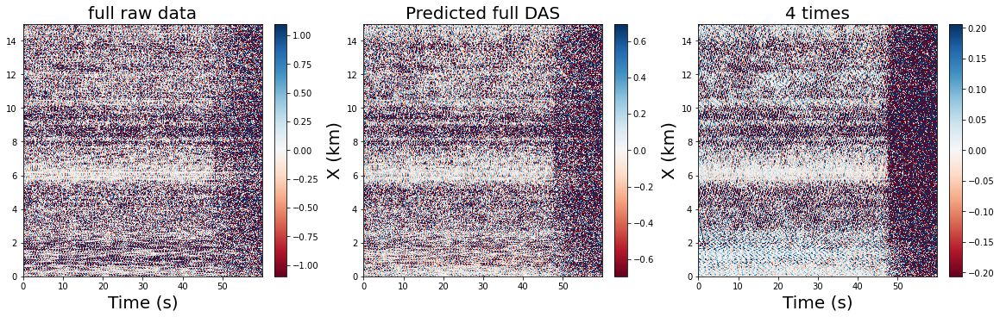

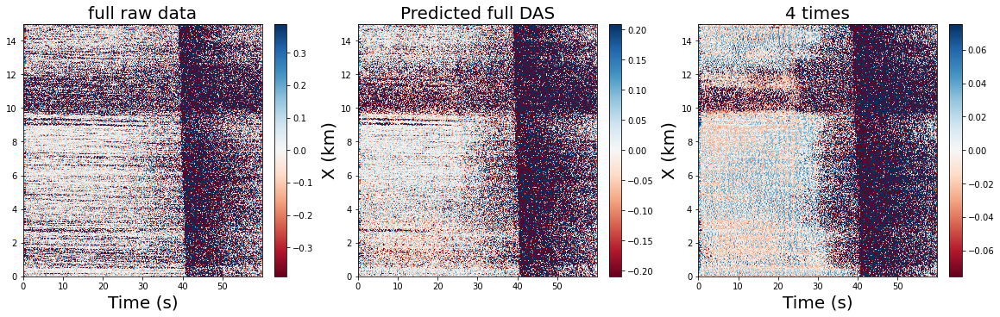

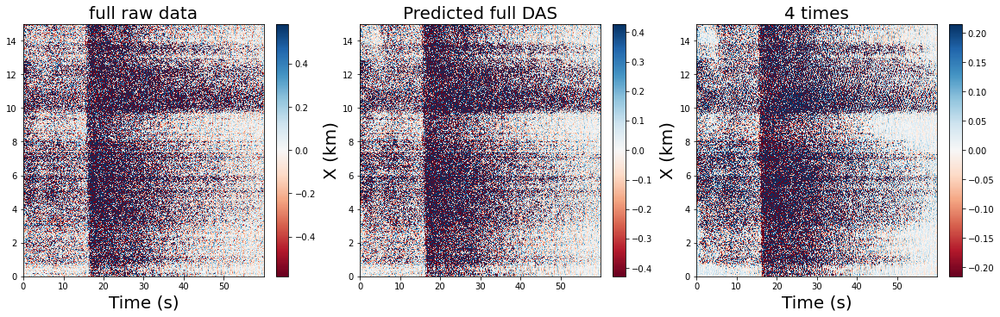

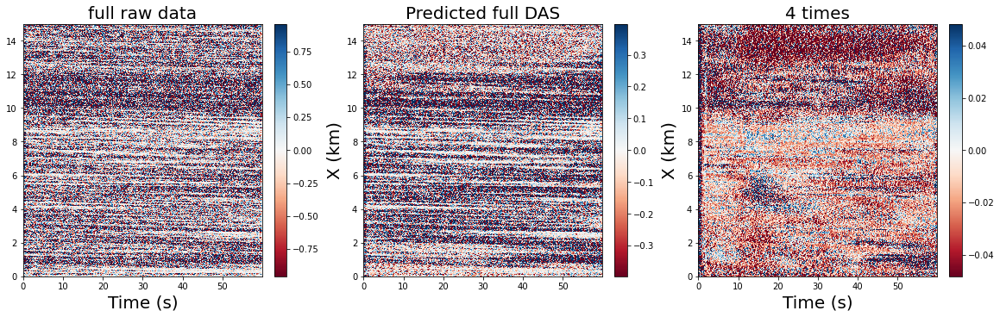

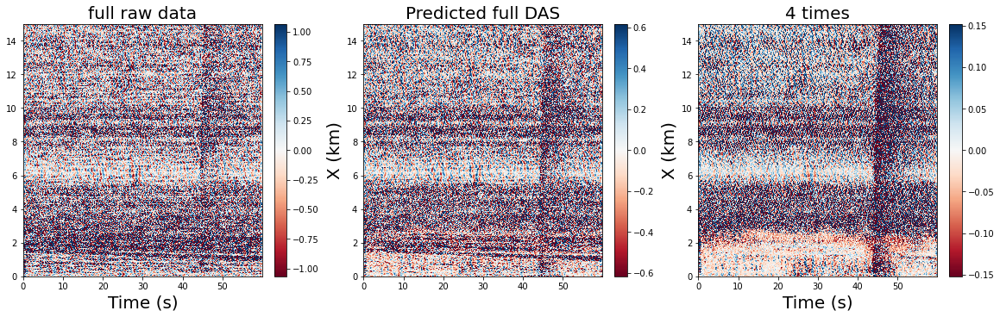

...

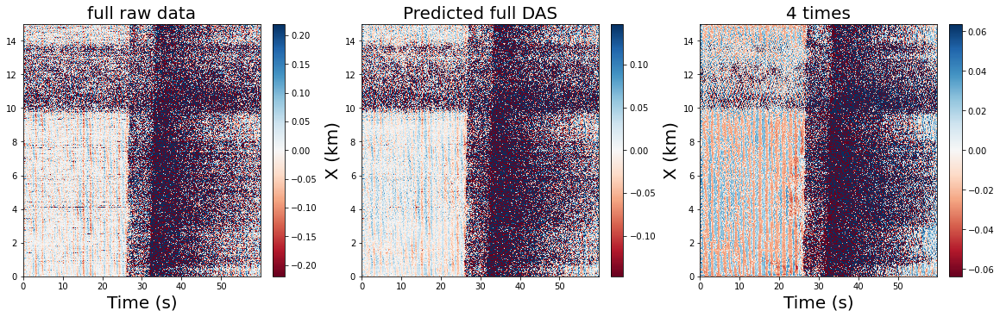

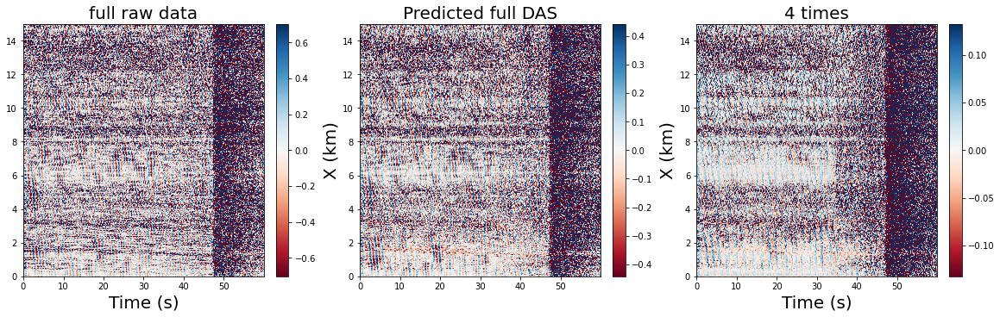

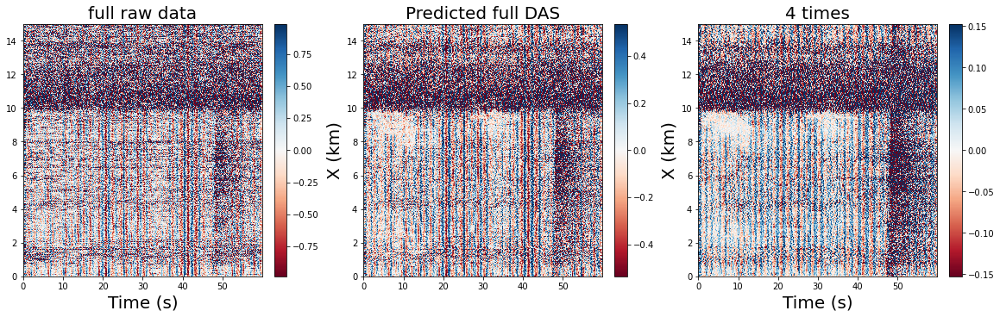

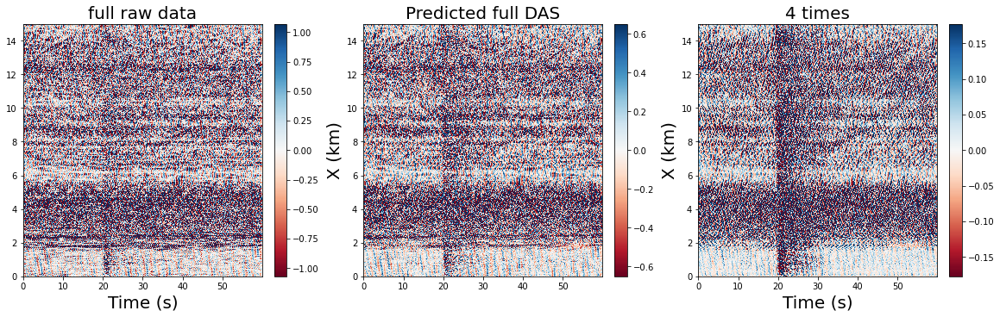

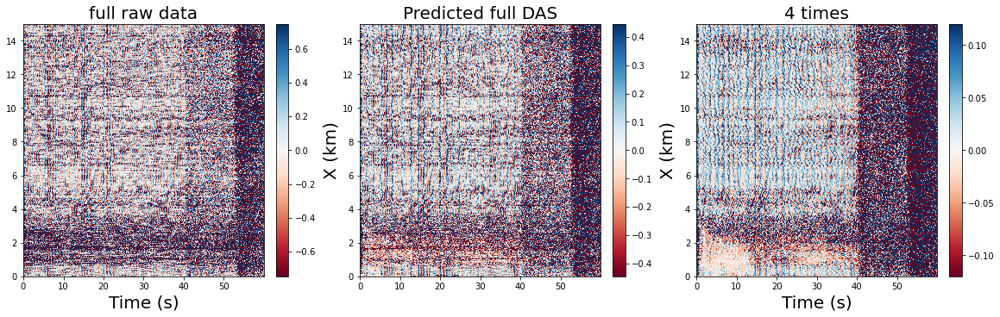

In [32]:
# %% numpy arrays
for ind in range(60,90):

    (X, mask), y = test_data[ind:ind+1]

    # %% convert to torch tensors
    X = torch.from_numpy(X).to(devc)
    mask = torch.from_numpy(mask).to(devc)

    # %% make a prediction use the best model
    with torch.no_grad():
        pred = model(X)
        tmp = model(pred)
        tmp = model(tmp)
        tmp = model(tmp)
        
    # %% convert back to numpy for plotting
    inputdata = X[0].to('cpu').numpy()
    denoised = tmp[0].to('cpu').numpy()
    pred = pred[0].to('cpu').numpy()


    # visualize all
    fig, ax = plt.subplots(1, 3, figsize=(16, 5), constrained_layout=True)

    x, y = np.arange(pred.shape[1]), np.arange(pred.shape[0])

    max_amp = np.median(np.fabs(inputdata)) *2 
    img=ax[0].pcolormesh(x, y, inputdata, shading='auto', vmin=-max_amp, vmax=max_amp, cmap=cmap)
    plt.colorbar(img, ax=ax[0])

    ax[0].set_xlabel("Time (s)", fontsize=20)
    ax[0].set_xticks(np.arange(0, 1500, 250)) 
    ax[0].set_xticklabels(np.arange(0, 1500/sample_rate, 250/sample_rate).astype(int))
    ax[0].set_title("full raw data", fontsize=20)
    ax[0].set_yticks(np.arange(0, 1500, 200))
    ax[0].set_yticklabels((np.arange(0, delta_space*1500, 200*delta_space)/1000).astype(int))

    max_amp = np.median(np.fabs(pred))*2
    img=ax[1].pcolormesh(x, y, pred, shading='auto', vmin=-max_amp, vmax=max_amp, cmap=cmap)
    plt.colorbar(img, ax=ax[1])

    ax[1].set_title("Predicted full DAS", fontsize=20)
    ax[1].set_xticks(np.arange(0, 1500, 250)) 
    ax[1].set_xticklabels(np.arange(0, 1500/sample_rate, 250/sample_rate).astype(int))
    ax[1].set_ylabel("X (km)", fontsize=20)
    ax[1].set_yticks(np.arange(0, 1500, 200))
    ax[1].set_yticklabels((np.arange(0, delta_space*1500, 200*delta_space)/1000).astype(int))

    max_amp = np.median(np.fabs(denoised))*2
    img=ax[2].pcolormesh(x, y, denoised, shading='auto', vmin=-max_amp, vmax=max_amp, cmap=cmap)
    plt.colorbar(img, ax=ax[2])

    ax[2].set_title("4 times", fontsize=20)
    ax[2].set_xlabel("Time (s)", fontsize=20)
    ax[2].set_xticks(np.arange(0, 1500, 250)) 
    ax[2].set_xticklabels(np.arange(0, 1500/sample_rate, 250/sample_rate).astype(int))
    ax[2].set_ylabel("X (km)", fontsize=20)
    ax[2].set_yticks(np.arange(0, 1500, 200))
    ax[2].set_yticklabels((np.arange(0, delta_space*1500, 200*delta_space)/1000).astype(int))

In [36]:
test_data = dataflow(X_te, mask_ratio=0.5)
len(test_data[0])

2

In [47]:
test_losses = []
loss_fn = nn.MSELoss()
with torch.no_grad():
    for batch, ((X, mask), y) in enumerate(test_data):

        X = torch.from_numpy(X[np.newaxis,:,:]).to(devc)
        mask = torch.from_numpy(mask[np.newaxis,:,:]).to(devc)
        y = torch.from_numpy(y[np.newaxis,:,:]).to(devc)

        pred = model(X * mask)
        loss = loss_fn(pred * (1-mask), y)
        test_losses.append(loss.item())

# average loss over an epoch
test_loss = np.average(test_losses)

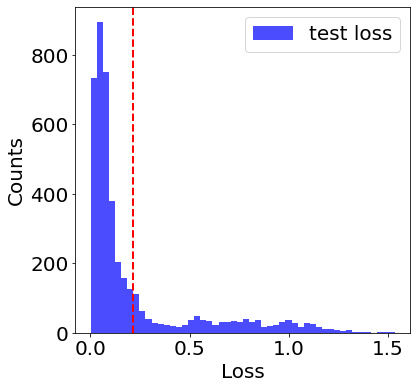

test loss: 0.2167


In [58]:
matplotlib.rcParams['font.family'] = 'sans-serif'
matplotlib.rcParams['font.sans-serif'] = ['DejaVu Sans']
matplotlib.rcParams['font.size'] = 20

plt.figure(figsize=(6, 6))
plt.hist(test_losses, bins=50, alpha=0.7, color='blue', label='test loss')
plt.axvline(test_loss, color='red', linestyle='dashed', linewidth=2)
plt.xlabel('Loss', fontsize=20)
plt.ylabel('Counts', fontsize=20)
plt.legend(fontsize=20)
plt.show()
print(f"test loss: {test_loss:.4f}")